## Introduction

This tutorial will give an introduction to DCGANs through an example.<br>
We will train a generative adversarial network (GAN) to generate new celebrities after showing it pictures of many real celebrities.

### What is a DCGAN?

A DCGAN is a direct extension of the GAN described above, except that it
explicitly uses convolutional and convolutional-transpose layers in the
discriminator and generator, respectively. It was first described by
Radford et. al. in the paper [Unsupervised Representation Learning With
Deep Convolutional Generative Adversarial
Networks](https://arxiv.org/pdf/1511.06434.pdf)_. The discriminator
is made up of strided
[convolution](https://pytorch.org/docs/stable/nn.html#torch.nn.Conv2d)_
layers, [batch
norm](https://pytorch.org/docs/stable/nn.html#torch.nn.BatchNorm2d)_
layers, and
[LeakyReLU](https://pytorch.org/docs/stable/nn.html#torch.nn.LeakyReLU)_
activations. The input is a 3x64x64 input image and the output is a
scalar probability that the input is from the real data distribution.
The generator is comprised of
[convolutional-transpose](https://pytorch.org/docs/stable/nn.html#torch.nn.ConvTranspose2d)_
layers, batch norm layers, and
[ReLU](https://pytorch.org/docs/stable/nn.html#relu)_ activations. The
input is a latent vector, $z$, that is drawn from a standard
normal distribution and the output is a 3x64x64 RGB image. The strided
conv-transpose layers allow the latent vector to be transformed into a
volume with the same shape as an image. In the paper, the authors also
give some tips about how to setup the optimizers, how to calculate the
loss functions, and how to initialize the model weights, all of which
will be explained in the coming sections.

In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


## Inputs

Let’s define some inputs for the run:

-  **dataroot** - the path to the root of the dataset folder. We will
   talk more about the dataset in the next section
-  **workers** - the number of worker threads for loading the data with
   the DataLoader
-  **batch_size** - the batch size used in training. The DCGAN paper
   uses a batch size of 128
-  **image_size** - the spatial size of the images used for training.
   This implementation defaults to 64x64. If another size is desired,
   the structures of D and G must be changed. See
   [here](https://github.com/pytorch/examples/issues/70)_ for more
   details
-  **nc** - number of color channels in the input images. For color
   images this is 3
-  **nz** - length of latent vector
-  **ngf** - relates to the depth of feature maps carried through the
   generator
-  **ndf** - sets the depth of feature maps propagated through the
   discriminator
-  **num_epochs** - number of training epochs to run. Training for
   longer will probably lead to better results but will also take much
   longer
-  **lr** - learning rate for training. As described in the DCGAN paper,
   this number should be 0.0002
-  **beta1** - beta1 hyperparameter for Adam optimizers. As described in
   paper, this number should be 0.5
-  **ngpu** - number of GPUs available. If this is 0, code will run in
   CPU mode. If this number is greater than 0 it will run on that number
   of GPUs




In [2]:
# Root directory for dataset
dataroot = '/home/armine/Downloads/celebA/celeba'

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

## Data

In this tutorial we will use the [Celeb-A Faces
dataset](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html)_ which can
be downloaded at the linked site, or in [Google
Drive](https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg)_.
The dataset will download as a file named *img_align_celeba.zip*. Once
downloaded, create a directory named *celeba* and extract the zip file
into that directory. Then, set the *dataroot* input for this notebook to
the *celeba* directory you just created. The resulting directory
structure should be:

::

   /path/to/celeba<br>
       -> img_align_celeba<br>  
           -> 188242.jpg<br>
           -> 173822.jpg<br>
           -> 284702.jpg<br>
           -> 537394.jpg<br>
              ...<br>

This is an important step because we will be using the ImageFolder
dataset class, which requires there to be subdirectories in the
dataset’s root folder. Now, we can create the dataset, create the
dataloader, set the device to run on, and finally visualize some of the
training data.

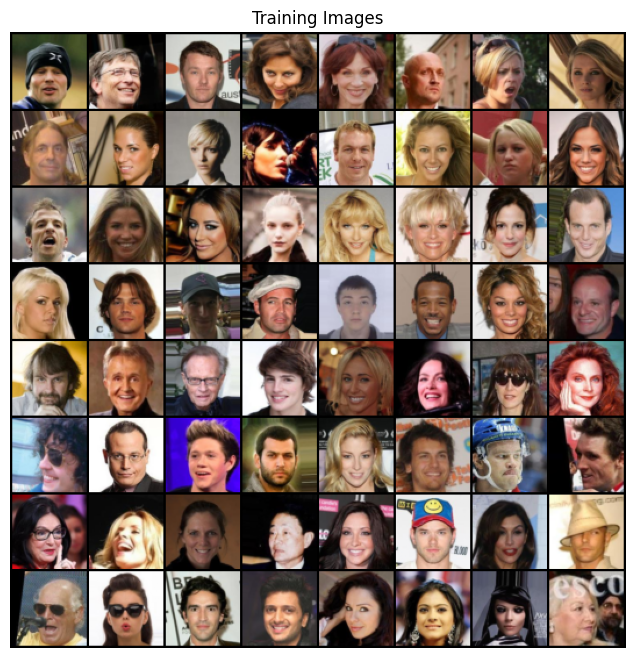

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

## Implementation

### Weight Initialization

From the DCGAN paper, the authors specify that all model weights shall
be randomly initialized from a Normal distribution with mean=0,
stdev=0.02. The ``weights_init`` function takes an initialized model as
input and reinitializes all convolutional, convolutional-transpose, and
batch normalization layers to meet this criteria. This function is
applied to the models immediately after initialization.

In [4]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### Generator

The generator, $G$, is designed to map the latent space vector
($z$) to data-space. Since our data are images, converting
$z$ to data-space means ultimately creating a RGB image with the
same size as the training images (i.e. 3x64x64). In practice, this is
accomplished through a series of strided two dimensional convolutional
transpose layers, each paired with a 2d batch norm layer and a relu
activation. The output of the generator is fed through a tanh function
to return it to the input data range of $[-1,1]$. It is worth
noting the existence of the batch norm functions after the
conv-transpose layers, as this is a critical contribution of the DCGAN
paper. These layers help with the flow of gradients during training. An
image of the generator from the DCGAN paper is shown below.

![Generator architecture](dcgan-gen.png)

Notice, how the inputs we set in the input section (*nz*, *ngf*, and
*nc*) influence the generator architecture in code. *nz* is the length
of the z input vector, *ngf* relates to the size of the feature maps
that are propagated through the generator, and *nc* is the number of
channels in the output image (set to 3 for RGB images). Below is the
code for the generator.




In [5]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [6]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


### Discriminator

As mentioned, the discriminator, $D$, is a binary classification
network that takes an image as input and outputs a scalar probability
that the input image is real (as opposed to fake). Here, $D$ takes
a 3x64x64 input image, processes it through a series of Conv2d,
BatchNorm2d, and LeakyReLU layers, and outputs the final probability
through a Sigmoid activation function. This architecture can be extended
with more layers if necessary for the problem, but there is significance
to the use of the strided convolution, BatchNorm, and LeakyReLUs. The
DCGAN paper mentions it is a good practice to use strided convolution
rather than pooling to downsample because it lets the network learn its
own pooling function. Also batch norm and leaky relu functions promote
healthy gradient flow which is critical for the learning process of both
$G$ and $D$.




In [7]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


### Loss Functions and Optimizers

With $D$ and $G$ setup, we can specify how they learn
through the loss functions and optimizers. We will use the Binary Cross
Entropy loss
([BCELoss](https://pytorch.org/docs/stable/nn.html#torch.nn.BCELoss)_)
function which is defined in PyTorch as:

\begin{align}\ell(x, y) = L = \{l_1,\dots,l_N\}^\top, \quad l_n = - \left[ y_n \cdot \log x_n + (1 - y_n) \cdot \log (1 - x_n) \right]\end{align}

Notice how this function provides the calculation of both log components
in the objective function (i.e. $log(D(x))$ and
$log(1-D(G(z)))$). We can specify what part of the BCE equation to
use with the $y$ input. This is accomplished in the training loop
which is coming up soon, but it is important to understand how we can
choose which component we wish to calculate just by changing $y$
(i.e. GT labels).

Next, we define our real label as 1 and the fake label as 0. These
labels will be used when calculating the losses of $D$ and
$G$, and this is also the convention used in the original GAN
paper. Finally, we set up two separate optimizers, one for $D$ and
one for $G$. As specified in the DCGAN paper, both are Adam
optimizers with learning rate 0.0002 and Beta1 = 0.5. For keeping track
of the generator’s learning progression, we will generate a fixed batch
of latent vectors that are drawn from a Gaussian distribution
(i.e. fixed_noise) . In the training loop, we will periodically input
this fixed_noise into $G$, and over the iterations we will see
images form out of the noise.




In [9]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

**Part 1 - Train the Discriminator**

Recall, the goal of training the discriminator is to maximize the
probability of correctly classifying a given input as real or fake. In
terms of Goodfellow, we wish to “update the discriminator by ascending
its stochastic gradient”. Practically, we want to maximize
$log(D(x)) + log(1-D(G(z)))$. Due to the separate mini-batch
suggestion from ganhacks, we will calculate this in two steps. First, we
will construct a batch of real samples from the training set, forward
pass through $D$, calculate the loss ($log(D(x))$), then
calculate the gradients in a backward pass. Secondly, we will construct
a batch of fake samples with the current generator, forward pass this
batch through $D$, calculate the loss ($log(1-D(G(z)))$),
and *accumulate* the gradients with a backward pass. Now, with the
gradients accumulated from both the all-real and all-fake batches, we
call a step of the Discriminator’s optimizer.

**Part 2 - Train the Generator**

As stated in the original paper, we want to train the Generator by
minimizing $log(1-D(G(z)))$ in an effort to generate better fakes.
As mentioned, this was shown by Goodfellow to not provide sufficient
gradients, especially early in the learning process. As a fix, we
instead wish to maximize $log(D(G(z)))$. In the code we accomplish
this by: classifying the Generator output from Part 1 with the
Discriminator, computing G’s loss *using real labels as GT*, computing
G’s gradients in a backward pass, and finally updating G’s parameters
with an optimizer step. It may seem counter-intuitive to use the real
labels as GT labels for the loss function, but this allows us to use the
$log(x)$ part of the BCELoss (rather than the $log(1-x)$
part) which is exactly what we want.

Finally, we will do some statistic reporting and at the end of each
epoch we will push our fixed_noise batch through the generator to
visually track the progress of G’s training. The training statistics
reported are:

-  **Loss_D** - discriminator loss calculated as the sum of losses for
   the all real and all fake batches ($log(D(x)) + log(1 - D(G(z)))$).
-  **Loss_G** - generator loss calculated as $log(D(G(z)))$
-  **D(x)** - the average output (across the batch) of the discriminator
   for the all real batch. This should start close to 1 then
   theoretically converge to 0.5 when G gets better. Think about why
   this is.
-  **D(G(z))** - average discriminator outputs for the all fake batch.
   The first number is before D is updated and the second number is
   after D is updated. These numbers should start near 0 and converge to
   0.5 as G gets better. Think about why this is.

Starting Training Loop...
[0/5][0/1583]	Loss_D: 1.7425	Loss_G: 5.4957	D(x): 0.5490	D(G(z)): 0.5731 / 0.0062


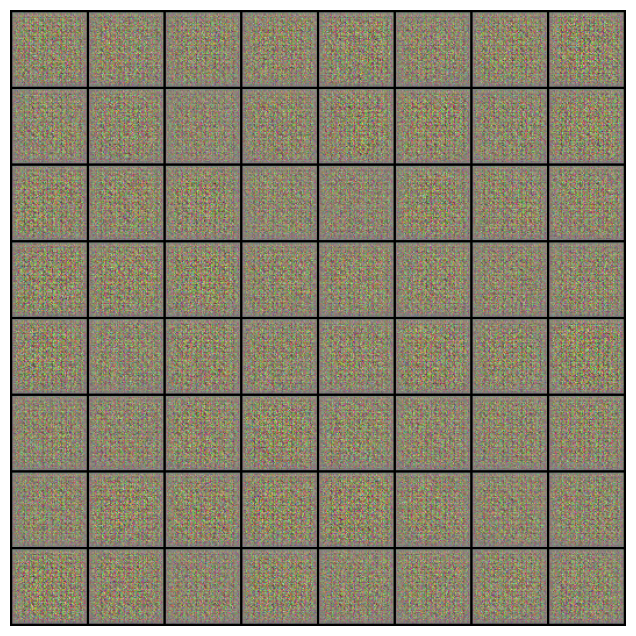

[0/5][50/1583]	Loss_D: 0.0084	Loss_G: 33.1185	D(x): 0.9944	D(G(z)): 0.0000 / 0.0000
[0/5][100/1583]	Loss_D: 0.0003	Loss_G: 34.4595	D(x): 0.9997	D(G(z)): 0.0000 / 0.0000
[0/5][150/1583]	Loss_D: 0.3934	Loss_G: 4.4477	D(x): 0.8748	D(G(z)): 0.1679 / 0.0329
[0/5][200/1583]	Loss_D: 0.7614	Loss_G: 7.5764	D(x): 0.8619	D(G(z)): 0.3700 / 0.0059
[0/5][250/1583]	Loss_D: 0.6548	Loss_G: 4.3547	D(x): 0.7919	D(G(z)): 0.2760 / 0.0261
[0/5][300/1583]	Loss_D: 0.6683	Loss_G: 3.7845	D(x): 0.6421	D(G(z)): 0.0432 / 0.0512
[0/5][350/1583]	Loss_D: 1.0924	Loss_G: 1.3090	D(x): 0.4564	D(G(z)): 0.0452 / 0.3487
[0/5][400/1583]	Loss_D: 1.0441	Loss_G: 3.3215	D(x): 0.5042	D(G(z)): 0.0171 / 0.0638
[0/5][450/1583]	Loss_D: 0.2681	Loss_G: 4.9927	D(x): 0.8733	D(G(z)): 0.0902 / 0.0220
[0/5][500/1583]	Loss_D: 0.5992	Loss_G: 3.7491	D(x): 0.8281	D(G(z)): 0.2659 / 0.0386


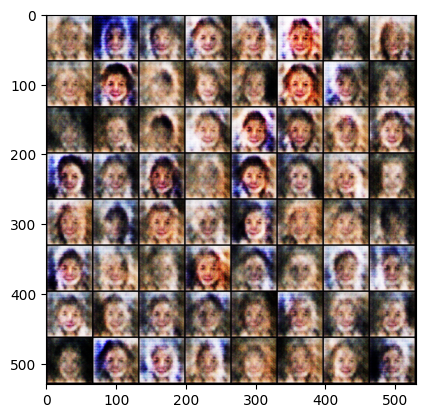

[0/5][550/1583]	Loss_D: 0.7046	Loss_G: 3.3373	D(x): 0.6799	D(G(z)): 0.1404 / 0.0681
[0/5][600/1583]	Loss_D: 0.3854	Loss_G: 5.6007	D(x): 0.9549	D(G(z)): 0.2529 / 0.0094
[0/5][650/1583]	Loss_D: 0.5448	Loss_G: 3.8360	D(x): 0.7835	D(G(z)): 0.1930 / 0.0379
[0/5][700/1583]	Loss_D: 0.6468	Loss_G: 6.0176	D(x): 0.8838	D(G(z)): 0.3351 / 0.0044
[0/5][750/1583]	Loss_D: 0.2543	Loss_G: 5.4306	D(x): 0.8497	D(G(z)): 0.0507 / 0.0088
[0/5][800/1583]	Loss_D: 0.3831	Loss_G: 6.7920	D(x): 0.7519	D(G(z)): 0.0059 / 0.0064
[0/5][850/1583]	Loss_D: 0.5498	Loss_G: 4.9986	D(x): 0.8987	D(G(z)): 0.2865 / 0.0156
[0/5][900/1583]	Loss_D: 0.5895	Loss_G: 2.4796	D(x): 0.7657	D(G(z)): 0.1742 / 0.1527
[0/5][950/1583]	Loss_D: 0.5780	Loss_G: 2.8440	D(x): 0.6787	D(G(z)): 0.0565 / 0.0943
[0/5][1000/1583]	Loss_D: 1.0552	Loss_G: 6.7980	D(x): 0.9506	D(G(z)): 0.5249 / 0.0033


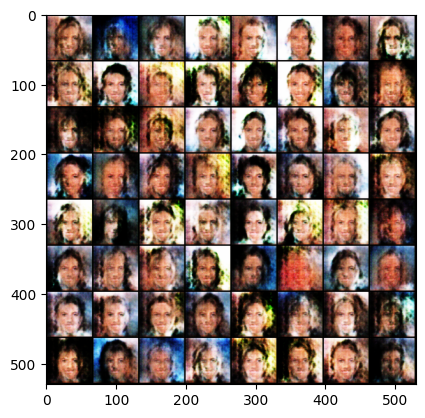

[0/5][1050/1583]	Loss_D: 0.6351	Loss_G: 2.6637	D(x): 0.6852	D(G(z)): 0.1250 / 0.1293
[0/5][1100/1583]	Loss_D: 0.5299	Loss_G: 3.5807	D(x): 0.7769	D(G(z)): 0.1598 / 0.0485
[0/5][1150/1583]	Loss_D: 0.5541	Loss_G: 3.3137	D(x): 0.8327	D(G(z)): 0.2474 / 0.0548
[0/5][1200/1583]	Loss_D: 0.7084	Loss_G: 6.0906	D(x): 0.9003	D(G(z)): 0.3826 / 0.0044
[0/5][1250/1583]	Loss_D: 0.7138	Loss_G: 3.3519	D(x): 0.7221	D(G(z)): 0.2108 / 0.0505
[0/5][1300/1583]	Loss_D: 1.1424	Loss_G: 3.6641	D(x): 0.4351	D(G(z)): 0.0063 / 0.0630
[0/5][1350/1583]	Loss_D: 0.5669	Loss_G: 3.4106	D(x): 0.7400	D(G(z)): 0.1459 / 0.0607
[0/5][1400/1583]	Loss_D: 1.8385	Loss_G: 1.7887	D(x): 0.2650	D(G(z)): 0.0021 / 0.2823
[0/5][1450/1583]	Loss_D: 0.9919	Loss_G: 2.5149	D(x): 0.4915	D(G(z)): 0.0174 / 0.1428
[0/5][1500/1583]	Loss_D: 0.7385	Loss_G: 4.8740	D(x): 0.9072	D(G(z)): 0.4155 / 0.0157


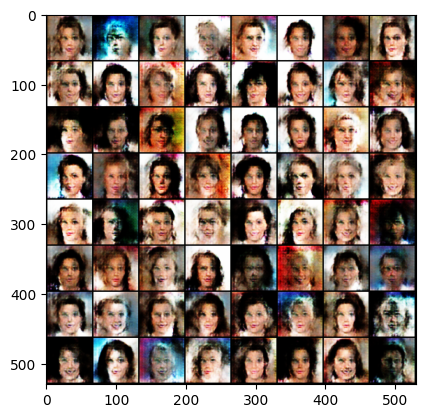

[0/5][1550/1583]	Loss_D: 0.4768	Loss_G: 2.4846	D(x): 0.7655	D(G(z)): 0.1478 / 0.1214
[1/5][0/1583]	Loss_D: 0.4974	Loss_G: 3.6066	D(x): 0.8342	D(G(z)): 0.2247 / 0.0411
[1/5][50/1583]	Loss_D: 0.3040	Loss_G: 3.5681	D(x): 0.8868	D(G(z)): 0.1408 / 0.0447
[1/5][100/1583]	Loss_D: 0.4485	Loss_G: 3.3286	D(x): 0.7891	D(G(z)): 0.1247 / 0.0587
[1/5][150/1583]	Loss_D: 0.3829	Loss_G: 4.7942	D(x): 0.8943	D(G(z)): 0.2075 / 0.0139
[1/5][200/1583]	Loss_D: 0.5276	Loss_G: 3.1993	D(x): 0.7845	D(G(z)): 0.1798 / 0.0600
[1/5][250/1583]	Loss_D: 0.6033	Loss_G: 3.6946	D(x): 0.6580	D(G(z)): 0.0604 / 0.0546
[1/5][300/1583]	Loss_D: 0.7045	Loss_G: 4.7558	D(x): 0.9184	D(G(z)): 0.3998 / 0.0146
[1/5][350/1583]	Loss_D: 0.8525	Loss_G: 5.2411	D(x): 0.9349	D(G(z)): 0.4650 / 0.0109
[1/5][400/1583]	Loss_D: 0.9892	Loss_G: 4.2787	D(x): 0.8373	D(G(z)): 0.4582 / 0.0298


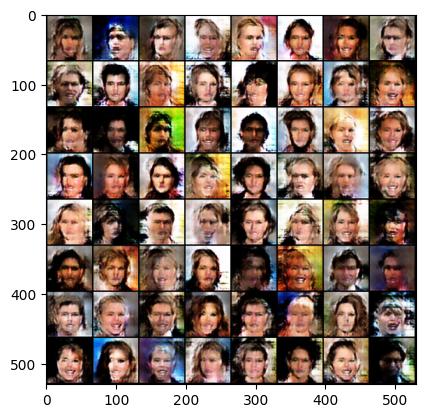

[1/5][450/1583]	Loss_D: 0.3774	Loss_G: 4.2068	D(x): 0.9070	D(G(z)): 0.2220 / 0.0212
[1/5][500/1583]	Loss_D: 0.8408	Loss_G: 2.1045	D(x): 0.6164	D(G(z)): 0.1556 / 0.1824
[1/5][550/1583]	Loss_D: 0.3377	Loss_G: 3.3036	D(x): 0.8423	D(G(z)): 0.1240 / 0.0573
[1/5][600/1583]	Loss_D: 0.4980	Loss_G: 4.0566	D(x): 0.8445	D(G(z)): 0.2451 / 0.0265
[1/5][650/1583]	Loss_D: 0.6647	Loss_G: 7.3768	D(x): 0.9173	D(G(z)): 0.3904 / 0.0011
[1/5][700/1583]	Loss_D: 1.0727	Loss_G: 4.8424	D(x): 0.9263	D(G(z)): 0.5664 / 0.0162
[1/5][750/1583]	Loss_D: 0.8150	Loss_G: 1.8084	D(x): 0.5595	D(G(z)): 0.0384 / 0.2325
[1/5][800/1583]	Loss_D: 0.5096	Loss_G: 4.0124	D(x): 0.8809	D(G(z)): 0.2733 / 0.0297
[1/5][850/1583]	Loss_D: 0.8990	Loss_G: 5.2876	D(x): 0.9243	D(G(z)): 0.4985 / 0.0103
[1/5][900/1583]	Loss_D: 0.4193	Loss_G: 2.8940	D(x): 0.7920	D(G(z)): 0.1285 / 0.0815


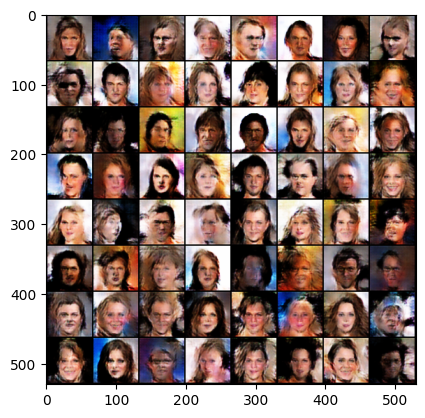

[1/5][950/1583]	Loss_D: 0.6811	Loss_G: 2.4025	D(x): 0.6004	D(G(z)): 0.0196 / 0.1381
[1/5][1000/1583]	Loss_D: 0.5134	Loss_G: 3.9730	D(x): 0.8614	D(G(z)): 0.2579 / 0.0331
[1/5][1050/1583]	Loss_D: 0.5631	Loss_G: 4.5940	D(x): 0.9024	D(G(z)): 0.3292 / 0.0145
[1/5][1100/1583]	Loss_D: 0.9919	Loss_G: 5.4783	D(x): 0.9651	D(G(z)): 0.5466 / 0.0115
[1/5][1150/1583]	Loss_D: 0.8688	Loss_G: 4.8760	D(x): 0.9476	D(G(z)): 0.4754 / 0.0139
[1/5][1200/1583]	Loss_D: 0.5507	Loss_G: 3.1446	D(x): 0.7511	D(G(z)): 0.1527 / 0.0700
[1/5][1250/1583]	Loss_D: 0.4623	Loss_G: 2.2551	D(x): 0.7782	D(G(z)): 0.1583 / 0.1321
[1/5][1300/1583]	Loss_D: 0.6010	Loss_G: 3.5595	D(x): 0.8298	D(G(z)): 0.2995 / 0.0415
[1/5][1350/1583]	Loss_D: 0.7509	Loss_G: 1.5370	D(x): 0.5604	D(G(z)): 0.0573 / 0.2748
[1/5][1400/1583]	Loss_D: 0.5797	Loss_G: 2.2042	D(x): 0.8415	D(G(z)): 0.2735 / 0.1587


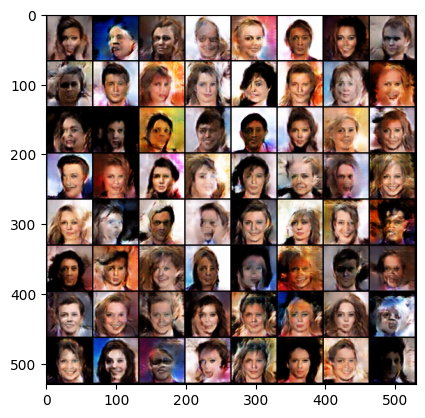

[1/5][1450/1583]	Loss_D: 0.7022	Loss_G: 1.3909	D(x): 0.5869	D(G(z)): 0.0742 / 0.3016
[1/5][1500/1583]	Loss_D: 1.0283	Loss_G: 3.8903	D(x): 0.8717	D(G(z)): 0.5225 / 0.0340
[1/5][1550/1583]	Loss_D: 0.5352	Loss_G: 2.8347	D(x): 0.8460	D(G(z)): 0.2764 / 0.0748
[2/5][0/1583]	Loss_D: 0.4376	Loss_G: 3.0291	D(x): 0.8109	D(G(z)): 0.1685 / 0.0727
[2/5][50/1583]	Loss_D: 0.6642	Loss_G: 3.9202	D(x): 0.9391	D(G(z)): 0.4155 / 0.0281
[2/5][100/1583]	Loss_D: 1.0618	Loss_G: 1.5553	D(x): 0.4206	D(G(z)): 0.0244 / 0.2686
[2/5][150/1583]	Loss_D: 0.5935	Loss_G: 2.3100	D(x): 0.8400	D(G(z)): 0.2987 / 0.1359
[2/5][200/1583]	Loss_D: 0.6193	Loss_G: 2.5876	D(x): 0.7961	D(G(z)): 0.2842 / 0.0984
[2/5][250/1583]	Loss_D: 0.8196	Loss_G: 2.8537	D(x): 0.7230	D(G(z)): 0.3135 / 0.0825
[2/5][300/1583]	Loss_D: 0.6530	Loss_G: 1.3770	D(x): 0.6348	D(G(z)): 0.1119 / 0.3000


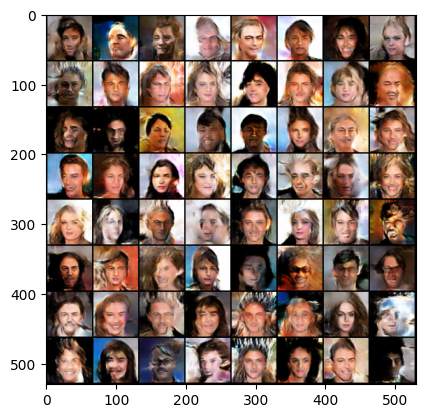

[2/5][350/1583]	Loss_D: 0.7824	Loss_G: 4.0472	D(x): 0.8975	D(G(z)): 0.4372 / 0.0263
[2/5][400/1583]	Loss_D: 0.5512	Loss_G: 2.3860	D(x): 0.7293	D(G(z)): 0.1682 / 0.1253
[2/5][450/1583]	Loss_D: 0.4286	Loss_G: 3.2539	D(x): 0.8844	D(G(z)): 0.2402 / 0.0528
[2/5][500/1583]	Loss_D: 0.3597	Loss_G: 2.8951	D(x): 0.8262	D(G(z)): 0.1336 / 0.0737
[2/5][550/1583]	Loss_D: 1.4759	Loss_G: 1.0562	D(x): 0.3129	D(G(z)): 0.0212 / 0.4179
[2/5][600/1583]	Loss_D: 1.2889	Loss_G: 0.1889	D(x): 0.3662	D(G(z)): 0.0782 / 0.8471
[2/5][650/1583]	Loss_D: 1.1551	Loss_G: 0.5260	D(x): 0.3886	D(G(z)): 0.0668 / 0.6239
[2/5][700/1583]	Loss_D: 1.0046	Loss_G: 4.7631	D(x): 0.9064	D(G(z)): 0.5464 / 0.0125
[2/5][750/1583]	Loss_D: 0.6676	Loss_G: 2.3239	D(x): 0.7398	D(G(z)): 0.2566 / 0.1324
[2/5][800/1583]	Loss_D: 0.9928	Loss_G: 4.0254	D(x): 0.8615	D(G(z)): 0.5176 / 0.0261


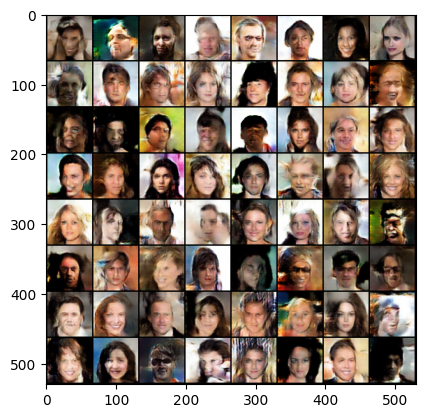

[2/5][850/1583]	Loss_D: 0.6408	Loss_G: 2.3957	D(x): 0.7648	D(G(z)): 0.2716 / 0.1201
[2/5][900/1583]	Loss_D: 1.6860	Loss_G: 4.9726	D(x): 0.9668	D(G(z)): 0.7505 / 0.0113
[2/5][950/1583]	Loss_D: 0.6563	Loss_G: 3.7507	D(x): 0.8875	D(G(z)): 0.3721 / 0.0331
[2/5][1000/1583]	Loss_D: 0.4556	Loss_G: 2.5026	D(x): 0.8086	D(G(z)): 0.1846 / 0.1065
[2/5][1050/1583]	Loss_D: 0.8719	Loss_G: 1.4051	D(x): 0.4981	D(G(z)): 0.0600 / 0.2891
[2/5][1100/1583]	Loss_D: 0.7483	Loss_G: 4.4980	D(x): 0.9029	D(G(z)): 0.4374 / 0.0166
[2/5][1150/1583]	Loss_D: 0.4905	Loss_G: 2.3096	D(x): 0.8304	D(G(z)): 0.2364 / 0.1199
[2/5][1200/1583]	Loss_D: 0.4332	Loss_G: 2.5591	D(x): 0.7425	D(G(z)): 0.0922 / 0.1034
[2/5][1250/1583]	Loss_D: 0.6774	Loss_G: 1.9292	D(x): 0.7111	D(G(z)): 0.2332 / 0.1801
[2/5][1300/1583]	Loss_D: 0.6645	Loss_G: 3.0751	D(x): 0.7961	D(G(z)): 0.3156 / 0.0604


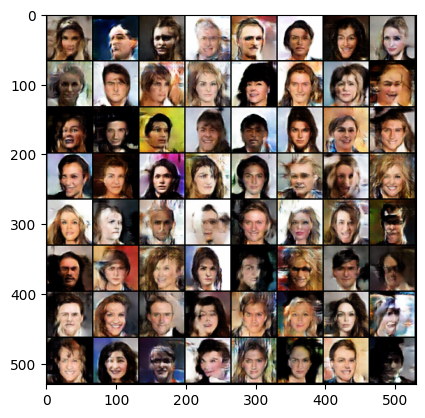

[2/5][1350/1583]	Loss_D: 0.6953	Loss_G: 2.5186	D(x): 0.8298	D(G(z)): 0.3624 / 0.1007
[2/5][1400/1583]	Loss_D: 0.6179	Loss_G: 1.9380	D(x): 0.6780	D(G(z)): 0.1365 / 0.1753
[2/5][1450/1583]	Loss_D: 0.6284	Loss_G: 3.0055	D(x): 0.7991	D(G(z)): 0.2884 / 0.0629
[2/5][1500/1583]	Loss_D: 0.6639	Loss_G: 3.9998	D(x): 0.8799	D(G(z)): 0.3825 / 0.0235
[2/5][1550/1583]	Loss_D: 0.4800	Loss_G: 2.9390	D(x): 0.8080	D(G(z)): 0.2045 / 0.0728
[3/5][0/1583]	Loss_D: 0.5376	Loss_G: 2.0662	D(x): 0.7641	D(G(z)): 0.2041 / 0.1507
[3/5][50/1583]	Loss_D: 0.7228	Loss_G: 3.1500	D(x): 0.8328	D(G(z)): 0.3653 / 0.0585
[3/5][100/1583]	Loss_D: 1.4027	Loss_G: 4.5535	D(x): 0.9005	D(G(z)): 0.6663 / 0.0174
[3/5][150/1583]	Loss_D: 0.7049	Loss_G: 3.6030	D(x): 0.9447	D(G(z)): 0.4416 / 0.0377
[3/5][200/1583]	Loss_D: 0.7463	Loss_G: 3.4191	D(x): 0.8494	D(G(z)): 0.4043 / 0.0410
[3/5][250/1583]	Loss_D: 0.5956	Loss_G: 3.1641	D(x): 0.8246	D(G(z)): 0.2960 / 0.0535


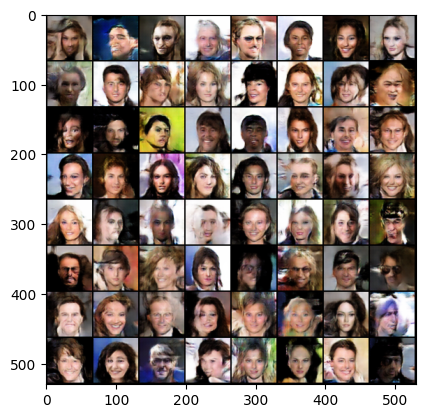

[3/5][300/1583]	Loss_D: 0.5677	Loss_G: 1.7443	D(x): 0.7445	D(G(z)): 0.2015 / 0.2174
[3/5][350/1583]	Loss_D: 0.6331	Loss_G: 2.9386	D(x): 0.8273	D(G(z)): 0.3206 / 0.0738
[3/5][400/1583]	Loss_D: 0.5108	Loss_G: 2.3901	D(x): 0.6728	D(G(z)): 0.0561 / 0.1200
[3/5][450/1583]	Loss_D: 0.8449	Loss_G: 1.0152	D(x): 0.5256	D(G(z)): 0.0719 / 0.4086
[3/5][500/1583]	Loss_D: 0.8750	Loss_G: 1.3967	D(x): 0.5479	D(G(z)): 0.1540 / 0.2902
[3/5][550/1583]	Loss_D: 0.5062	Loss_G: 2.7189	D(x): 0.8673	D(G(z)): 0.2831 / 0.0819
[3/5][600/1583]	Loss_D: 0.9043	Loss_G: 1.0961	D(x): 0.5167	D(G(z)): 0.0968 / 0.3792
[3/5][650/1583]	Loss_D: 0.8742	Loss_G: 1.6774	D(x): 0.5259	D(G(z)): 0.1141 / 0.2436
[3/5][700/1583]	Loss_D: 0.4689	Loss_G: 2.1348	D(x): 0.7897	D(G(z)): 0.1810 / 0.1477
[3/5][750/1583]	Loss_D: 0.5748	Loss_G: 3.2086	D(x): 0.8643	D(G(z)): 0.3150 / 0.0550


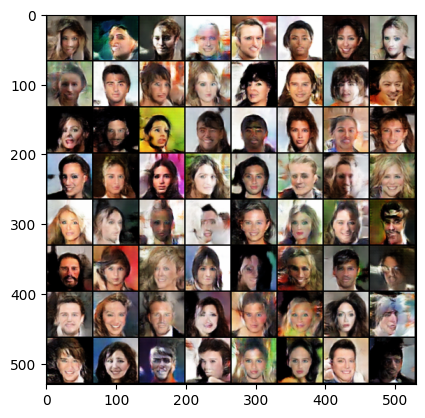

[3/5][800/1583]	Loss_D: 0.5053	Loss_G: 2.4011	D(x): 0.7815	D(G(z)): 0.1986 / 0.1110
[3/5][850/1583]	Loss_D: 1.1338	Loss_G: 5.0249	D(x): 0.8796	D(G(z)): 0.5802 / 0.0094
[3/5][900/1583]	Loss_D: 1.3128	Loss_G: 0.3832	D(x): 0.3356	D(G(z)): 0.0273 / 0.7148
[3/5][950/1583]	Loss_D: 0.6066	Loss_G: 1.8684	D(x): 0.6527	D(G(z)): 0.1088 / 0.1983
[3/5][1000/1583]	Loss_D: 0.6503	Loss_G: 3.2071	D(x): 0.8444	D(G(z)): 0.3477 / 0.0542
[3/5][1050/1583]	Loss_D: 0.7856	Loss_G: 1.4404	D(x): 0.6106	D(G(z)): 0.1866 / 0.2755
[3/5][1100/1583]	Loss_D: 0.4363	Loss_G: 2.5002	D(x): 0.8299	D(G(z)): 0.1984 / 0.1078
[3/5][1150/1583]	Loss_D: 0.7770	Loss_G: 1.4571	D(x): 0.5537	D(G(z)): 0.0958 / 0.2793
[3/5][1200/1583]	Loss_D: 0.7116	Loss_G: 1.1111	D(x): 0.5846	D(G(z)): 0.1014 / 0.3804
[3/5][1250/1583]	Loss_D: 0.5396	Loss_G: 1.9852	D(x): 0.6765	D(G(z)): 0.0908 / 0.1768


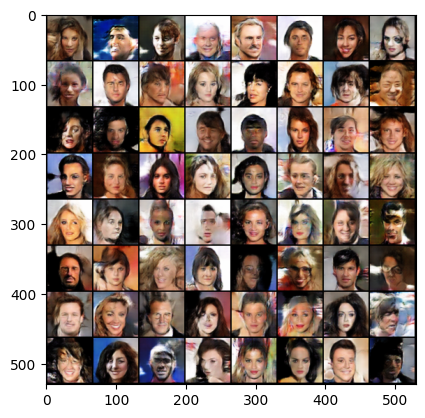

[3/5][1300/1583]	Loss_D: 0.6158	Loss_G: 2.5522	D(x): 0.6790	D(G(z)): 0.1504 / 0.1074
[3/5][1350/1583]	Loss_D: 0.8742	Loss_G: 1.3967	D(x): 0.5520	D(G(z)): 0.1578 / 0.2886
[3/5][1400/1583]	Loss_D: 1.2238	Loss_G: 1.1165	D(x): 0.3820	D(G(z)): 0.0767 / 0.3959
[3/5][1450/1583]	Loss_D: 0.5997	Loss_G: 3.1033	D(x): 0.8505	D(G(z)): 0.3229 / 0.0555
[3/5][1500/1583]	Loss_D: 0.9535	Loss_G: 0.9614	D(x): 0.4933	D(G(z)): 0.1030 / 0.4343
[3/5][1550/1583]	Loss_D: 0.5705	Loss_G: 3.0627	D(x): 0.8761	D(G(z)): 0.3243 / 0.0605
[4/5][0/1583]	Loss_D: 0.5692	Loss_G: 1.7301	D(x): 0.6988	D(G(z)): 0.1452 / 0.2245
[4/5][50/1583]	Loss_D: 0.4992	Loss_G: 3.3570	D(x): 0.8848	D(G(z)): 0.2866 / 0.0495
[4/5][100/1583]	Loss_D: 1.3541	Loss_G: 1.1122	D(x): 0.3543	D(G(z)): 0.0810 / 0.3901
[4/5][150/1583]	Loss_D: 0.5572	Loss_G: 2.0944	D(x): 0.7361	D(G(z)): 0.1826 / 0.1576


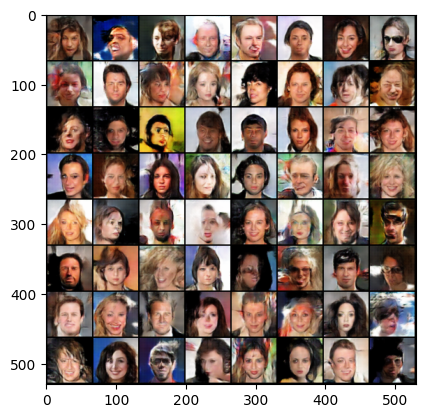

[4/5][200/1583]	Loss_D: 0.4602	Loss_G: 2.3218	D(x): 0.7514	D(G(z)): 0.1270 / 0.1247
[4/5][250/1583]	Loss_D: 0.5029	Loss_G: 1.8483	D(x): 0.7402	D(G(z)): 0.1559 / 0.1865
[4/5][300/1583]	Loss_D: 0.9645	Loss_G: 0.9864	D(x): 0.4739	D(G(z)): 0.0875 / 0.4235
[4/5][350/1583]	Loss_D: 0.6745	Loss_G: 1.5614	D(x): 0.6032	D(G(z)): 0.0867 / 0.2540
[4/5][400/1583]	Loss_D: 1.2030	Loss_G: 3.3512	D(x): 0.8456	D(G(z)): 0.5621 / 0.0619
[4/5][450/1583]	Loss_D: 0.4794	Loss_G: 2.4579	D(x): 0.8157	D(G(z)): 0.2167 / 0.1111
[4/5][500/1583]	Loss_D: 0.7154	Loss_G: 1.9142	D(x): 0.6246	D(G(z)): 0.1529 / 0.1859
[4/5][550/1583]	Loss_D: 0.4841	Loss_G: 1.8403	D(x): 0.6989	D(G(z)): 0.0833 / 0.2064
[4/5][600/1583]	Loss_D: 0.6743	Loss_G: 2.9991	D(x): 0.7790	D(G(z)): 0.2993 / 0.0656
[4/5][650/1583]	Loss_D: 0.5435	Loss_G: 2.3041	D(x): 0.7550	D(G(z)): 0.1946 / 0.1194


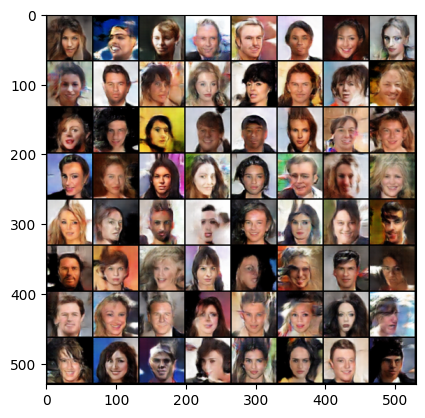

[4/5][700/1583]	Loss_D: 0.4519	Loss_G: 3.1165	D(x): 0.8481	D(G(z)): 0.2270 / 0.0570
[4/5][750/1583]	Loss_D: 0.5477	Loss_G: 2.1616	D(x): 0.7470	D(G(z)): 0.1876 / 0.1469
[4/5][800/1583]	Loss_D: 0.5602	Loss_G: 1.7309	D(x): 0.7020	D(G(z)): 0.1449 / 0.2164
[4/5][850/1583]	Loss_D: 0.6833	Loss_G: 2.0301	D(x): 0.6603	D(G(z)): 0.1726 / 0.1753
[4/5][900/1583]	Loss_D: 1.0564	Loss_G: 3.7741	D(x): 0.9384	D(G(z)): 0.5754 / 0.0335
[4/5][950/1583]	Loss_D: 1.0192	Loss_G: 3.9167	D(x): 0.9331	D(G(z)): 0.5429 / 0.0307
[4/5][1000/1583]	Loss_D: 0.4008	Loss_G: 2.5349	D(x): 0.8180	D(G(z)): 0.1565 / 0.0995
[4/5][1050/1583]	Loss_D: 0.6179	Loss_G: 2.1227	D(x): 0.7630	D(G(z)): 0.2420 / 0.1500
[4/5][1100/1583]	Loss_D: 0.7223	Loss_G: 2.7020	D(x): 0.6653	D(G(z)): 0.1998 / 0.0912
[4/5][1150/1583]	Loss_D: 0.4751	Loss_G: 2.1738	D(x): 0.8155	D(G(z)): 0.2074 / 0.1440


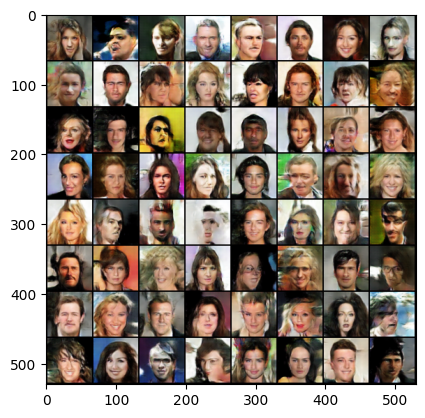

[4/5][1200/1583]	Loss_D: 0.5188	Loss_G: 2.8468	D(x): 0.9085	D(G(z)): 0.3059 / 0.0787
[4/5][1250/1583]	Loss_D: 0.5593	Loss_G: 2.8800	D(x): 0.8323	D(G(z)): 0.2810 / 0.0714
[4/5][1300/1583]	Loss_D: 2.0063	Loss_G: 6.3436	D(x): 0.9645	D(G(z)): 0.7994 / 0.0032
[4/5][1350/1583]	Loss_D: 0.4861	Loss_G: 2.1356	D(x): 0.7851	D(G(z)): 0.1886 / 0.1444
[4/5][1400/1583]	Loss_D: 0.5375	Loss_G: 2.9804	D(x): 0.8267	D(G(z)): 0.2586 / 0.0693
[4/5][1450/1583]	Loss_D: 0.8549	Loss_G: 3.4197	D(x): 0.8458	D(G(z)): 0.4358 / 0.0457
[4/5][1500/1583]	Loss_D: 0.4351	Loss_G: 2.5946	D(x): 0.7557	D(G(z)): 0.1100 / 0.1045
[4/5][1550/1583]	Loss_D: 1.1575	Loss_G: 0.5693	D(x): 0.3992	D(G(z)): 0.0740 / 0.6050


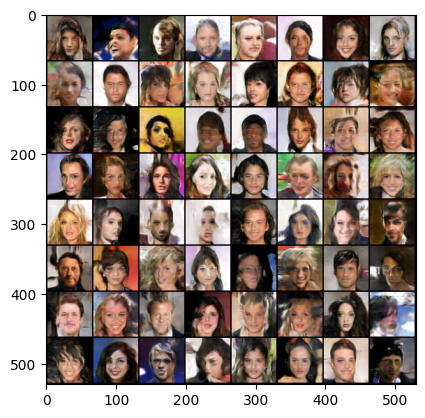

In [10]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

fig = plt.figure(figsize=(8,8))
plt.axis("off")

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True),(1,2,0)))
            plt.show()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))


        iters += 1

## Results

Finally, lets check out how we did. Here, we will look at three
different results. First, we will see how D and G’s losses changed
during training. Second, we will visualize G’s output on the fixed_noise
batch for every epoch. And third, we will look at a batch of real data
next to a batch of fake data from G.

**Loss versus training iteration**

Below is a plot of D & G’s losses versus training iterations.




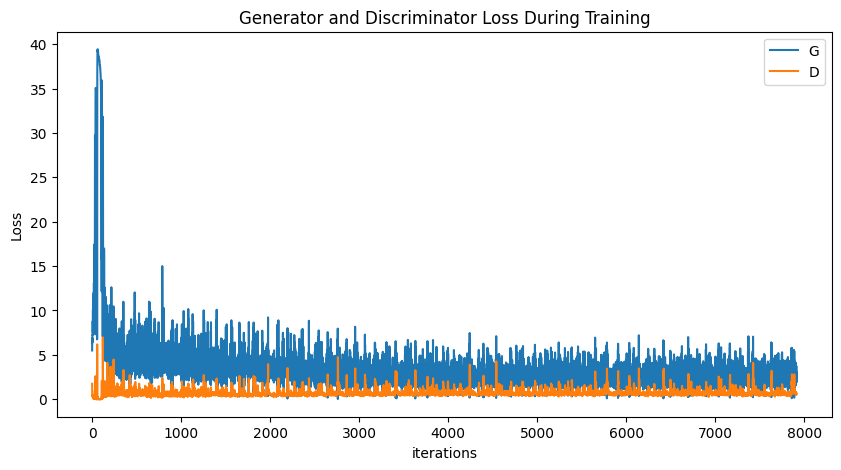

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Visualization of G’s progression**

Remember how we saved the generator’s output on the fixed_noise batch
after every epoch of training. Now, we can visualize the training
progression of G with an animation. Press the play button to start the
animation.

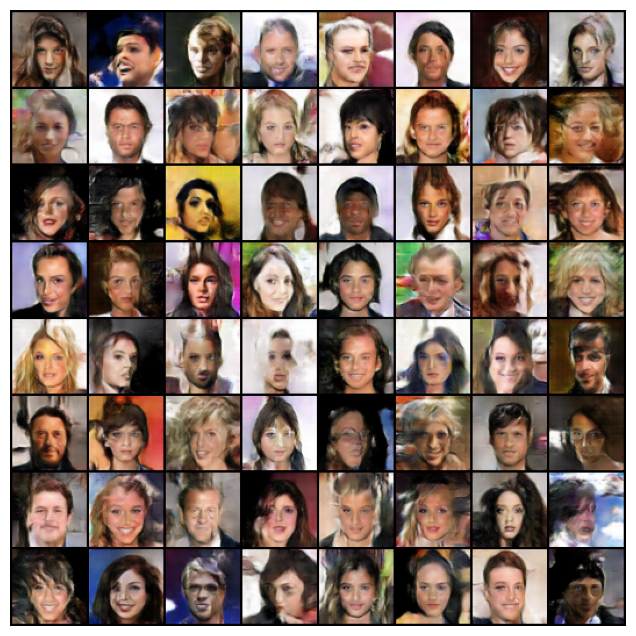

In [12]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Real Images vs. Fake Images**

Finally, lets take a look at some real images and fake images side by
side.

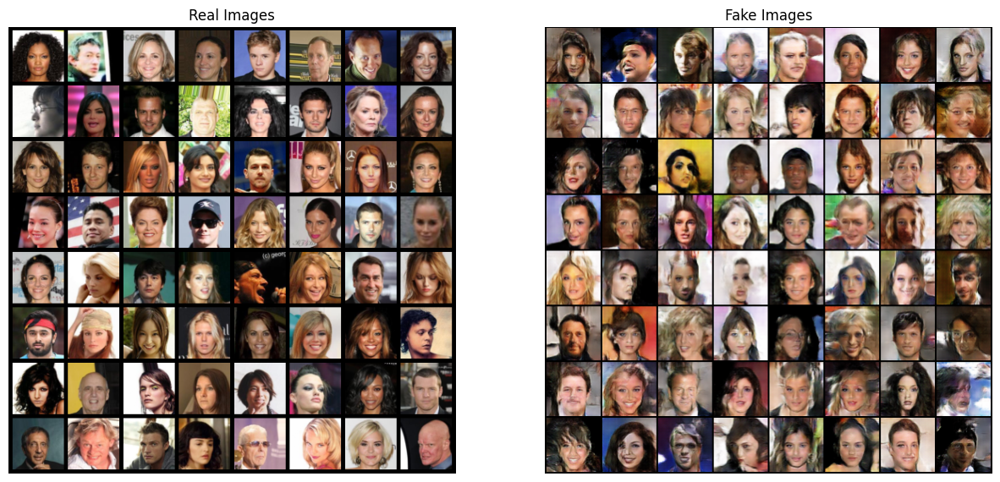

In [13]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()